<a href="https://colab.research.google.com/github/Vayansh/Sentiment_Analysis/blob/main/MulticlasstoxicCommentClassification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install kaggle
from google.colab import files

files.upload()
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json


In [ ]:
!kaggle competitions download -c jigsaw-multilingual-toxic-comment-classification



100% 1.08G/1.08G [00:39<00:00, 33.2MB/s]
100% 1.08G/1.08G [00:39<00:00, 29.6MB/s]


In [ ]:
!unzip '/content/jigsaw-multilingual-toxic-comment-classification.zip'

Archive:  /content/jigsaw-multilingual-toxic-comment-classification.zip
  inflating: jigsaw-toxic-comment-train-processed-seqlen128.csv  
  inflating: jigsaw-toxic-comment-train.csv  
  inflating: jigsaw-unintended-bias-train-processed-seqlen128.csv  
  inflating: jigsaw-unintended-bias-train.csv  
  inflating: sample_submission.csv   
  inflating: test-processed-seqlen128.csv  
  inflating: test.csv                
  inflating: test_labels.csv         
  inflating: validation-processed-seqlen128.csv  
  inflating: validation.csv          


In [ ]:
import pandas as pd

In [ ]:
df_train= pd.read_csv('jigsaw-toxic-comment-train.csv')
df_train.head(10)

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0
5,00025465d4725e87,"""\n\nCongratulations from me as well, use the ...",0,0,0,0,0,0
6,0002bcb3da6cb337,COCKSUCKER BEFORE YOU PISS AROUND ON MY WORK,1,1,1,0,1,0
7,00031b1e95af7921,Your vandalism to the Matt Shirvington article...,0,0,0,0,0,0
8,00037261f536c51d,Sorry if the word 'nonsense' was offensive to ...,0,0,0,0,0,0
9,00040093b2687caa,alignment on this subject and which are contra...,0,0,0,0,0,0


In [ ]:
pip install -U spacy

In [ ]:
import spacy

In [ ]:
!python -m spacy download en_core_web_lg

2023-08-24 18:55:24.321206: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 587.7/587.7 MB 658.2 kB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.pipeline import make_pipeline,Pipeline
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC
from sklearn.multioutput import MultiOutputClassifier
from sklearn.metrics import f1_score,accuracy_score
from sklearn.model_selection import GridSearchCV
from sklearn.multiclass import OneVsRestClassifier
import warnings
import spacy
#en_nlp = spacy.load('en')



```
# This is formatted as code
```

# 1. Exploratory data analysis

In [ ]:
df_train.head()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate,clean_comment_text
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0,explanation why the edits made under my userna...
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0,daww he matches this background colour im seem...
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0,hey man im really not trying to edit war its j...
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0,more i cant make any real suggestions on impr...
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0,you sir are my hero any chance you remember wh...


In [ ]:
print(df_train.shape)
print("Train dataset columns = {}".format(df_train.columns))

(223549, 9)
Train dataset columns = Index(['id', 'comment_text', 'toxic', 'severe_toxic', 'obscene', 'threat',
       'insult', 'identity_hate', 'clean_comment_text'],
      dtype='object')


In [ ]:
categories=['toxic', 'severe_toxic', 'obscene', 'threat','insult', 'identity_hate']
train_labels=df_train[categories]
labels_count=train_labels.sum()
print(labels_count)

toxic            21384
severe_toxic      1962
obscene          12140
threat             689
insult           11304
identity_hate     2117
dtype: int64


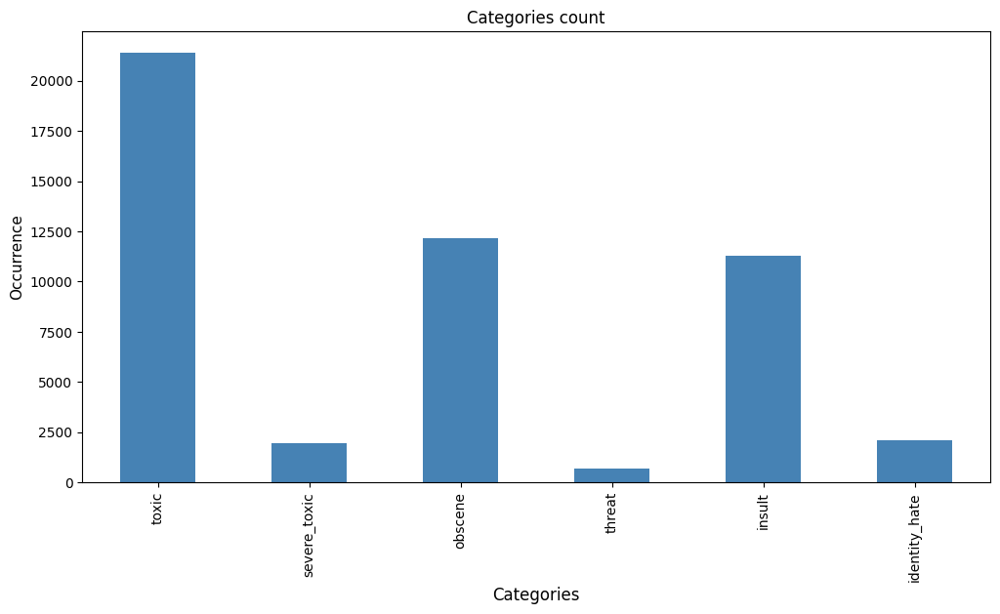

<Figure size 640x480 with 0 Axes>

In [ ]:
plt.figure(figsize=(12,6))
labels_count.plot(kind='bar', title='Labels Frequency', color='steelblue')
plt.title('Categories count')
plt.ylabel('Occurrence', fontsize=11)
plt.xlabel('Categories', fontsize=12)
plt.show()

plt.savefig('my_plot.png')

<ipython-input-20-b5347986a34f>:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  rowsums = df_train.iloc[:,2:].sum(axis=1)


Toxicity label representation
 Categories number- Occurence-Percentage of dataset
0	 201081	 89.95 
1	 8202	 3.67 
3	 6290	 2.81 
2	 5010	 2.24 
4	 2371	 1.06 
5	 550	 0.25 
6	 45	 0.02 


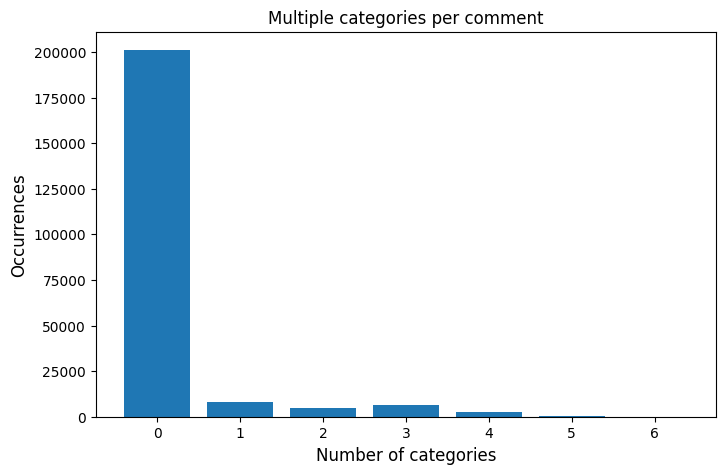

In [ ]:
rowsums = df_train.iloc[:,2:].sum(axis=1)
categ_representation=rowsums.value_counts()
print("Toxicity label representation\n Categories number- Occurence-Percentage of dataset")
for nb,occ in zip(categ_representation.index,categ_representation.values):
  print("{}\t {}\t {:.2f} ".format(nb,occ,occ/len(df_train)*100))
plt.figure(figsize=(8,5))
plt.bar(categ_representation.index, categ_representation.values)
plt.title("Multiple categories per comment")
plt.ylabel('Occurrences', fontsize=12)
plt.xlabel('Number of categories', fontsize=12)
plt.show()

# 2. Data preprocessing

In [ ]:
X=df_train['comment_text']
print('First comment:\n {}'.format(X[0]))


First comment:
 Explanation
Why the edits made under my username Hardcore Metallica Fan were reverted? They weren't vandalisms, just closure on some GAs after I voted at New York Dolls FAC. And please don't remove the template from the talk page since I'm retired now.89.205.38.27


In [ ]:
def convert_to_lower(text):
    text=str(text)
    return text.lower()

def remove_punctuation(text):
    return text.translate(str.maketrans(" "," ",string.punctuation))

def remove_extra_white_space(text):
    single_char_pattern = r'\s+'
    without_sc = re.sub(pattern=single_char_pattern, repl = " ", string=text)
    return without_sc

def remove_number(text):
    single_char_pattern = r'\d+'
    without_digit = re.sub(pattern=single_char_pattern, repl = " ", string=text)
    return without_digit

def remove_non_ascii(text):
    return re.sub(r'[^\x00-\x7F]',' ',text)

In [ ]:
# covert to lower letter, numbers, punctuation, non-ascii and extra-white space removeal
import string
df_train['clean_comment_text']= df_train['comment_text'].apply(lambda x: convert_to_lower(x))
df_train['clean_comment_text']= df_train['clean_comment_text'].apply(lambda x: remove_punctuation(x))
df_train['clean_comment_text']= df_train['clean_comment_text'].apply(lambda x: remove_extra_white_space(x))
df_train['clean_comment_text']= df_train['clean_comment_text'].apply(lambda x: remove_number(x))
df_train['clean_comment_text']= df_train['clean_comment_text'].apply(lambda x: remove_non_ascii(x))
df_train.head(10)


,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate,clean_comment_text
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0,explanation why the edits made under my userna...
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0,daww he matches this background colour im seem...
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0,hey man im really not trying to edit war its j...
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0,more i cant make any real suggestions on impr...
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0,you sir are my hero any chance you remember wh...
5,00025465d4725e87,"""\n\nCongratulations from me as well, use the ...",0,0,0,0,0,0,congratulations from me as well use the tools...
6,0002bcb3da6cb337,COCKSUCKER BEFORE YOU PISS AROUND ON MY WORK,1,1,1,0,1,0,cocksucker before you piss around on my work
7,00031b1e95af7921,Your vandalism to the Matt Shirvington article...,0,0,0,0,0,0,your vandalism to the matt shirvington article...
8,00037261f536c51d,Sorry if the word 'nonsense' was offensive to ...,0,0,0,0,0,0,sorry if the word nonsense was offensive to yo...
9,00040093b2687caa,alignment on this subject and which are contra...,0,0,0,0,0,0,alignment on this subject and which are contra...


In [ ]:
X_clean = df_train['clean_comment_text']

In [ ]:
y=df_train[categories]
y

,toxic,severe_toxic,obscene,threat,insult,identity_hate
0,0,0,0,0,0,0
1,0,0,0,0,0,0
2,0,0,0,0,0,0
3,0,0,0,0,0,0
4,0,0,0,0,0,0
...,...,...,...,...,...,...
223544,0,0,0,0,0,0
223545,0,0,0,0,0,0
223546,0,0,0,0,0,0
223547,1,0,1,0,1,0


# 3. Machine learning

In [ ]:
y.iloc[:,0]

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score,hamming_loss

In [ ]:
def training_model(model):
    X_train,X_test,y_train,y_test=train_test_split(X_clean,y,random_state=0)
    model.fit(X_train,y_train)
    # y_train_pred=predictions=model.predict(X_train)
    y_test_pred=model.predict(X_test)
    print("hamming loss = {}".format(hamming_loss(y_test, y_test_pred)))
    print("accuracy score = {}".format(accuracy_score(y_test, y_test_pred)))

    f1_score_cat=[f1_score(y_test.iloc[:,count],y_test_pred[:,count], average='weighted') for count in range(len(categories))]
    acuracy_score_cat=[accuracy_score(y_test.iloc[:,count],y_test_pred[:,count]) for count in range(len(categories))]
    precision_score_cat=[precision_score(y_test.iloc[:,count],y_test_pred[:,count]) for count in range(len(categories))]
    recall_score_cat=[recall_score(y_test.iloc[:,count],y_test_pred[:,count]) for count in range(len(categories))]

    dic={category:[f1Score,acc,pre,rec] for category,f1Score,acc,pre,rec in zip(categories,f1_score_cat,acuracy_score_cat,precision_score_cat,recall_score_cat)}
    return pd.Series(data=dic,index=categories,name='f1_score')

def custom_tokenizer(document):
    doc_spacy = en_nlp(document)
    return [token.lemma_ for token in doc_spacy]

# Mute warnings
warnings.filterwarnings('ignore')

# Multinomial Naive Bayes

## Standard count vectorizer

In [ ]:
clfNB=Pipeline([('cvec',CountVectorizer()),('nb',MultiOutputClassifier(MultinomialNB()))])
f1_score_clfNB=training_model(clfNB)
f1_score_clfNB

hamming loss = 0.02796664758087604
accuracy score = 0.9004437446321214


toxic            [0.935015787235587, 0.9393071858001718, 0.7515...
severe_toxic     [0.9878315702235954, 0.9870097337532208, 0.290...
obscene          [0.9608934724875535, 0.9630153163469797, 0.706...
threat           [0.9945462457721914, 0.9948289436014887, 0.044...
insult           [0.9579371933794288, 0.960367162897223, 0.6405...
identity_hate    [0.9865090275001005, 0.9876717721156599, 0.230...
Name: f1_score, dtype: object

In [ ]:
print(f1_score_clfNB.toxic)
print(f1_score_clfNB.severe_toxic)
print(f1_score_clfNB.obscene)
print(f1_score_clfNB.threat)
print(f1_score_clfNB.insult)
print(f1_score_clfNB.identity_hate)

[0.935015787235587, 0.9393071858001718, 0.7515939811272635, 0.5493010251630941]
[0.9878315702235954, 0.9870097337532208, 0.29064039408866993, 0.37579617834394907]
[0.9608934724875535, 0.9630153163469797, 0.7060542797494781, 0.5537000654878848]
[0.9945462457721914, 0.9948289436014887, 0.04477611940298507, 0.03592814371257485]
[0.9579371933794288, 0.960367162897223, 0.6405677655677655, 0.4945210321668434]
[0.9865090275001005, 0.9876717721156599, 0.2303206997084548, 0.15674603174603174]


In [ ]:
clfNB.predict_proba(X_clean[:2])

[array([[1.00000000e+00, 3.18928265e-13],
        [9.99986266e-01, 1.37339292e-05]]),
 array([[1.00000000e+00, 5.01362621e-40],
        [1.00000000e+00, 3.33084427e-13]]),
 array([[1.00000000e+00, 1.19978585e-17],
        [9.99999831e-01, 1.68710522e-07]]),
 array([[1.00000000e+00, 5.30943188e-49],
        [1.00000000e+00, 1.21727538e-15]]),
 array([[1.00000000e+00, 1.11171052e-18],
        [9.99999720e-01, 2.79573249e-07]]),
 array([[1.00000000e+00, 1.29138787e-34],
        [1.00000000e+00, 1.26352713e-12]])]

### Lime Explainability

In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283839 sha256=cbdad1c327da5250f0ad6c2b7ad0a6bcbe6a610100875da66df830bf87df0956
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
from lime.lime_text import LimeTextExplainer


In [ ]:
class Explainer:
  def __init__(self,model):
    self.m = model
    self.texplainer = LimeTextExplainer(class_names = ['Non_toxic','Toxic'])
    self.sexplainer = LimeTextExplainer(class_names = ['Non_Severe_toxic','Severe_Toxic'])
    self.oexplainer = LimeTextExplainer(class_names = ['Non_Obscene','Obscene'])
    self.thexplainer = LimeTextExplainer(class_names = ['Non_threat','Threat'])
    self.inexplainer = LimeTextExplainer(class_names = ['Non_insult','Insult'])
    self.ihexplainer = LimeTextExplainer(class_names = ['Non_Identity_hate','Identity Hate'])

  def _tpredict_proba(self,x):
    return self.m.predict_proba(x)[0]


  def _spredict_proba(self,x):
    return self.m.predict_proba(x)[1]


  def _opredict_proba(self,x):
    return self.m.predict_proba(x)[2]


  def _thpredict_proba(self,x):
    return self.m.predict_proba(x)[3]


  def _inpredict_proba(self,x):
    return self.m.predict_proba(x)[4]


  def _ihpredict_proba(self,x):
    return self.m.predict_proba(x)[5]


  def explain(self,idx):

    print("Data to explain: ", df_train.clean_comment_text[idx])
    print("True values: ", y.iloc[idx])


    exp = self.texplainer.explain_instance(df_train.clean_comment_text[idx], self._tpredict_proba, num_features=10)
    exp.as_list()
    exp.show_in_notebook()

    sexp = self.sexplainer.explain_instance(df_train.clean_comment_text[idx], self._spredict_proba, num_features=10)
    sexp.as_list()
    sexp.show_in_notebook()

    oexp = self.oexplainer.explain_instance(df_train.clean_comment_text[idx], self._opredict_proba, num_features=10)
    oexp.as_list()
    oexp.show_in_notebook()

    thexp = self.thexplainer.explain_instance(df_train.clean_comment_text[idx], self._thpredict_proba, num_features=10)
    thexp.as_list()
    thexp.show_in_notebook()

    inexp = self.inexplainer.explain_instance(df_train.clean_comment_text[idx], self._inpredict_proba, num_features=10)
    inexp.as_list()
    inexp.show_in_notebook()

    ihexp = self.ihexplainer.explain_instance(df_train.clean_comment_text[idx], self._ihpredict_proba, num_features=10)
    ihexp.as_list()
    ihexp.show_in_notebook()


In [ ]:
df_train.sample(10)


In [ ]:
idx=4174
exp = Explainer(model = clfNB)
exp.explain(idx)

Data to explain:  ii can still post with this computeri said block me come the fuck down here and arrest mesan diego california chula vista fucking get your information right faggot shitheadi can still post with this computeri said block me come the fuck down here and arrest mesan diego california chula vista fucking get your information right faggot shitheadi can still post with this computeri said block me come the fuck down here and arrest mesan diego california chula vista fucking get your information right faggot shitheadi can still post with this computeri said block me come the fuck down here and arrest mesan diego california chula vista fucking get your information right faggot shitheadi can still post with this computeri said block me come the fuck down here and arrest mesan diego california chula vista fucking get your information right faggot shitheadi can still post with this computeri said block me come the fuck down here and arrest mesan diego california chula vista fucki

*italicized text*### Shap Explainability

In [ ]:
!pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.1/547.1 kB 8.1 MB/s eta 0:00:00


In [ ]:
import shap

In [ ]:
masker = shap.maskers.Text(tokenizer=r"\W+")
explainer = shap.Explainer(clfNB.predict, masker=masker,output_names = ['Toxic','Severe_Toxic','Obscene','Threat','Insult','Identity_Hate'])


In [ ]:
shap_values = explainer([X_clean[42]])

In [ ]:
y.iloc[42]

toxic            1
severe_toxic     0
obscene          1
threat           0
insult           1
identity_hate    1
Name: 42, dtype: int64

In [ ]:
#you are gay or antisemmitian archangel white tiger meow greetingshhh uh there are two ways why you do erased my comment about ww  that holocaust was brutally slaying of jews and not gaysgypsysslavsanyone   if you are antisemitian than shave your head bald and go to the skinhead meetings   if you doubt words of the bible that homosexuality is a deadly sin make a pentagram tatoo on your forehead go to the satanistic masses with your gay pals   first and last warning you fucking gay i wont appreciate if any more nazi shwain would write in my page i dont wish to talk to you anymore beware of the dark side

In [ ]:
shap.text_plot(shap_values)

In [ ]:
idx=4174
shap_values = explainer([X_clean[idx]])
print(y.iloc[idx])
shap.text_plot(shap_values)

toxic            1
severe_toxic     0
obscene          1
threat           0
insult           1
identity_hate    0
Name: 4174, dtype: int64


## Tfidf vectorizer

In [ ]:
clf_tfidf_NB=Pipeline([('tfidf', TfidfVectorizer()),('nb',MultiOutputClassifier(MultinomialNB()))])
f1_score_clf_tfidf_NB=training_model(clf_tfidf_NB)
f1_score_clf_tfidf_NB

hamming loss = 0.03454826319305277
accuracy score = 0.8999248496993988


toxic            [0.8818901906437173, 0.9142749785284855, 0.983...
severe_toxic     [0.9873764769812492, 0.9915724305754365, 0.0, ...
obscene          [0.9263741420026381, 0.9485220440881763, 0.983...
threat           [0.9955200569109826, 0.9970118809046665, 0.0, ...
insult           [0.9271832337800548, 0.9503471228170627, 0.95,...
identity_hate    [0.9864933692246092, 0.9909819639278558, 0.0, ...
Name: f1_score, dtype: object

In [ ]:
print(f1_score_clf_tfidf_NB.toxic)
print(f1_score_clf_tfidf_NB.severe_toxic)
print(f1_score_clf_tfidf_NB.obscene)
print(f1_score_clf_tfidf_NB.threat)
print(f1_score_clf_tfidf_NB.insult)
print(f1_score_clf_tfidf_NB.identity_hate)


[0.8818901906437173, 0.9142749785284855, 0.9831649831649831, 0.10885368126747437]
[0.9873764769812492, 0.9915724305754365, 0.0, 0.0]
[0.9263741420026381, 0.9485220440881763, 0.9836065573770492, 0.05893909626719057]
[0.9955200569109826, 0.9970118809046665, 0.0, 0.0]
[0.9271832337800548, 0.9503471228170627, 0.95, 0.02014846235418876]
[0.9864933692246092, 0.9909819639278558, 0.0, 0.0]


In [ ]:
exp = Explainer(model = clf_tfidf_NB)
exp.explain(42)

Data to explain:  you are gay or antisemmitian archangel white tiger meow greetingshhh uh there are two ways why you do erased my comment about ww  that holocaust was brutally slaying of jews and not gaysgypsysslavsanyone   if you are antisemitian than shave your head bald and go to the skinhead meetings   if you doubt words of the bible that homosexuality is a deadly sin make a pentagram tatoo on your forehead go to the satanistic masses with your gay pals   first and last warning you fucking gay i wont appreciate if any more nazi shwain would write in my page i dont wish to talk to you anymore beware of the dark side
True values:  toxic            1
severe_toxic     0
obscene          1
threat           0
insult           1
identity_hate    1
Name: 42, dtype: int64


### Shap Explainability

In [ ]:
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import shap

In [ ]:
id = 5000

In [ ]:
masker = shap.maskers.Text(tokenizer=r"\W+")
explainer = shap.Explainer(clf_tfidf_NB.predict, masker=masker,output_names = ['Toxic','Severe_Toxic','Obscene','Threat','Insult','Identity_Hate'])


In [ ]:
shap_values = explainer([X_clean[id]])

In [ ]:
y.iloc[id]

toxic            1
severe_toxic     0
obscene          1
threat           0
insult           1
identity_hate    0
Name: 5000, dtype: int64

In [ ]:
clf_tfidf_NB.predict([X_clean[id]])

array([[0, 0, 0, 0, 0, 0]])

In [ ]:
shap.text_plot(shap_values)

# Word2Vec

## Logistic Regression

In [ ]:
import gensim
import pandas as pd
from nltk.tokenize import word_tokenize
from gensim.models import Word2Vec

In [ ]:
nlp = spacy.load('en_core_web_lg', disable=["tagger", "parser", "ner"])

# create train set by getting the document vector
docs_train = [nlp(doc).vector for doc in X_clean]
X_clean = np.vstack(docs_train)
print('Shape of train set: {}'.format(X_clean.shape))

# # create test set likewise
# docs_test = [nlp(doc).vector for doc in test.text]
# X_test = np.vstack(docs_test)

In [ ]:
X_clean

In [ ]:
X_train,X_test,y_train,y_test=train_test_split(X_clean,y,random_state=0)


In [ ]:
from sklearn.model_selection import cross_val_score, GridSearchCV

In [ ]:
word2vec_pipe = Pipeline([('estimator', MultiOutputClassifier(LinearSVC()))])

# # cross validate
print('F1 score: {:.3f}'.format(np.mean(cross_val_score(word2vec_pipe, X_train, y_train, scoring = 'f1'))))

# fit pipeline
word2vec_pipe.fit(X_train, y_train)

# predict on test set
pred = word2vec_pipe.predict(X_test)

In [ ]:
w2v_model = Word2Vec(X_clean)#, size=100) #, window=5, min_count=5, workers=4)


In [ ]:
w2v_model

In [ ]:
w2v_model(X_1[0])

In [ ]:
from gensim.models import Word2Vec
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
nltk.download('punkt')
nltk.download('stopwords')

In [ ]:
stop_words = stopwords.words('english')

In [ ]:
X_1 = X.apply(lambda x: [word.lower() for word in word_tokenize(x) if word.isalpha() and word.lower() not in stop_words])

In [ ]:
from gensim.models import Word2Vec
from sklearn.pipeline import Pipeline
from sklearn.naive_bayes import MultinomialNB
from sklearn.feature_extraction.text import TfidfVectorizer

In [ ]:
clfSVC=Pipeline([('w2v',()),('svc',MultiOutputClassifier(LinearSVC()))])
f1_score_clfSVC=training_model(clfSVC)
f1_score_clfSVC

# Linear Support Vector Machine classifier

## Standard count vectorizer

In [ ]:
clfSVC=Pipeline([('cvec',CountVectorizer()),('svc',MultiOutputClassifier(LinearSVC()))])
f1_score_clfSVC=training_model(clfSVC)
f1_score_clfSVC

KeyboardInterrupt: ignored

In [ ]:
print(f1_score_clfSVC.toxic)
print(f1_score_clfSVC.severe_toxic)
print(f1_score_clfSVC.obscene)
print(f1_score_clfSVC.threat)
print(f1_score_clfSVC.insult)
print(f1_score_clfSVC.identity_hate)


In [ ]:
exp = Explainer(model = clfSVC)
exp.explain(42)

### Shap Explainability


In [ ]:
!pip install shap

In [ ]:
import shap

masker = shap.maskers.Text(tokenizer=r"\W+")
explainer = shap.Explainer(clfSVC.predict, masker=masker,output_names = ['Toxic','Severe_Toxic','Obscene','Threat','Insult','Identity_Hate'])


shap_values = explainer([X_clean[42]])

print(y.iloc[42])

shap.text_plot(shap_values)

## Tfidf vectorizer

In [ ]:
clf_tfidf_SVC=Pipeline([('tfidf', TfidfVectorizer()),('svc',MultiOutputClassifier(LinearSVC()))])
f1_score_clf_tfidf_SVC=training_model(clf_tfidf_SVC)
f1_score_clf_tfidf_SVC

hamming loss = 0.02005499093424945
accuracy score = 0.9153127683939307


toxic            [0.9515122217079953, 0.9539436014886916, 0.828...
severe_toxic     [0.9899339651605974, 0.9913398225021471, 0.472...
obscene          [0.9737133441225474, 0.9750751503006012, 0.842...
threat           [0.9968792378178188, 0.9973518465502433, 0.620...
insult           [0.9676786412583441, 0.969814629258517, 0.7721...
identity_hate    [0.990781978523653, 0.9921450042943029, 0.6337...
Name: f1_score, dtype: object

In [ ]:
print(f1_score_clf_tfidf_SVC.toxic)
print(f1_score_clf_tfidf_SVC.severe_toxic)
print(f1_score_clf_tfidf_SVC.obscene)
print(f1_score_clf_tfidf_SVC.threat)
print(f1_score_clf_tfidf_SVC.insult)
print(f1_score_clf_tfidf_SVC.identity_hate)


[0.9515122217079953, 0.9539436014886916, 0.8287396937573616, 0.6557315936626281]
[0.9899339651605974, 0.9913398225021471, 0.47280334728033474, 0.23991507430997877]
[0.9737133441225474, 0.9750751503006012, 0.8427569129178704, 0.6686313032089064]
[0.9968792378178188, 0.9973518465502433, 0.620253164556962, 0.2934131736526946]
[0.9676786412583441, 0.969814629258517, 0.7721639656816015, 0.5726405090137858]
[0.990781978523653, 0.9921450042943029, 0.6337448559670782, 0.3055555555555556]


In [ ]:
exp = Explainer(model = clf_tfidf_SVC)
exp.explain(42)

Data to explain:  you are gay or antisemmitian archangel white tiger meow greetingshhh uh there are two ways why you do erased my comment about ww  that holocaust was brutally slaying of jews and not gaysgypsysslavsanyone   if you are antisemitian than shave your head bald and go to the skinhead meetings   if you doubt words of the bible that homosexuality is a deadly sin make a pentagram tatoo on your forehead go to the satanistic masses with your gay pals   first and last warning you fucking gay i wont appreciate if any more nazi shwain would write in my page i dont wish to talk to you anymore beware of the dark side
True values:  toxic            1
severe_toxic     0
obscene          1
threat           0
insult           1
identity_hate    1
Name: 42, dtype: int64


AttributeError: ignored

### Shap Explainability


In [ ]:
!pip install shap


In [ ]:
import shap

masker = shap.maskers.Text(tokenizer=r"\W+")
explainer = shap.Explainer(clf_tfidf_SVC.predict, masker=masker,output_names = ['Toxic','Severe_Toxic','Obscene','Threat','Insult','Identity_Hate'])


shap_values = explainer([X_clean[42]])

print(y.iloc[42])

shap.text_plot(shap_values)

# Logistic Regression

## Standard count vectorizer

In [ ]:
cvLG=Pipeline([('cvec',CountVectorizer(min_df=5)),('lg',MultiOutputClassifier(LogisticRegression(solver='liblinear', max_iter=500)))])
f1_score_cvLG=training_model(cvLG)
f1_score_cvLG

In [ ]:
print(f1_score_cvLG.toxic)
print(f1_score_cvLG.severe_toxic)
print(f1_score_cvLG.obscene)
print(f1_score_cvLG.threat)
print(f1_score_cvLG.insult)
print(f1_score_cvLG.identity_hate)


In [ ]:
exp = Explainer(model = cvLG)
exp.explain(42)

### Shap Explainability


In [ ]:
!pip install shap


In [ ]:
import shap

masker = shap.maskers.Text(tokenizer=r"\W+")
explainer = shap.Explainer(cvLG.predict, masker=masker,output_names = ['Toxic','Severe_Toxic','Obscene','Threat','Insult','Identity_Hate'])

shap_values = explainer([X_clean[42]])

print(y.iloc[42])

shap.text_plot(shap_values)

## Tfidf vectorizer

In [ ]:
cv_tfidf_LG=Pipeline([('tfidf', TfidfVectorizer()),('lg',MultiOutputClassifier(LogisticRegression(solver='sag', max_iter=500)))])
f1_score_cv_tfidf_LG=training_model(cv_tfidf_LG)
f1_score_cv_tfidf_LG

In [ ]:
print(f1_score_cv_tfidf_LG.toxic)
print(f1_score_cv_tfidf_LG.severe_toxic)
print(f1_score_cv_tfidf_LG.obscene)
print(f1_score_cv_tfidf_LG.threat)
print(f1_score_cv_tfidf_LG.insult)
print(f1_score_cv_tfidf_LG.identity_hate)


In [ ]:
exp = Explainer(model = cv_tfidf_LG)
exp.explain(42)

### Shap Explainability


In [ ]:
!pip install shap


In [ ]:
import shap

masker = shap.maskers.Text(tokenizer=r"\W+")
explainer = shap.Explainer(cv_tfidf_LG.predict, masker=masker,output_names = ['Toxic','Severe_Toxic','Obscene','Threat','Insult','Identity_Hate'])


shap_values = explainer([X_clean[42]])

print(y.iloc[42])

shap.text_plot(shap_values)

# Parameters tuning with GridSearch CV

In [ ]:
X_train,X_test,y_train,y_test=train_test_split(X_clean,y,random_state=0)

## Logistic Regression

In [ ]:
cvLG=Pipeline([('cvec',CountVectorizer(min_df=5)),('lg',MultiOutputClassifier(LogisticRegression(solver='liblinear', max_iter=500)))])

In [ ]:
grid_params= {
 'cvec__ngram_range': [(1, 1)],
 'lg__estimator__C':[1,10],
}
model_gs=GridSearchCV(cvLG,param_grid=grid_params,cv=5,scoring='f1_weighted',verbose=5,n_jobs=-1)

model_gs.fit(X_train,y_train)
print("Best parameters {}".format(model_gs.best_params_))
print("Best score: {:.3f}".format(model_gs.best_score_))

In [ ]:
y_test_pred=model_gs.predict(X_test)
print("f1 score (test dataset) = {}".format(f1_score(y_test, y_test_pred, average='weighted')))

## Linear Support Vector Machine classifier

In [ ]:
grid_params= {
#  'cvec__ngram_range': [(1, 1)],
 'svc__estimator__C':[1,10],
}
clfSVC=Pipeline([('svc',MultiOutputClassifier(LinearSVC()))])
grid_clfSVC=GridSearchCV(clfSVC,param_grid=grid_params,cv=5,scoring='f1_weighted',verbose=5,n_jobs=-1)
grid_clfSVC.fit(X_train,y_train)
print("Best parameters {}".format(grid_clfSVC.best_params_))
print("Best score: {:.3f}".format(grid_clfSVC.best_score_))

In [ ]:
y_test_pred=grid_clfSVC.predict(X_test)
print("f1 score (test dataset) = {}".format(f1_score(y_test, y_test_pred, average='weighted')))

In [ ]:
grid_params= {
 'tfidf__ngram_range': [(1, 1),(1,2)],
 'svc__estimator__C':[0.1,1,10],
}
clf_tfidf_SVC=Pipeline([('tfidf', TfidfVectorizer()),('svc',MultiOutputClassifier(LinearSVC()))])
grid_clf_tfidf_SVC=GridSearchCV(clf_tfidf_SVC,param_grid=grid_params,cv=5,scoring='f1_weighted',verbose=5,n_jobs=-1)
grid_clf_tfidf_SVC.fit(X_train,y_train)
print("Best parameters {}".format(grid_clf_tfidf_SVC.best_params_))
print("Best score: {:.3f}".format(grid_clf_tfidf_SVC.best_score_))

In [ ]:
y_test_pred=grid_clf_tfidf_SVC.predict(X_test)
print("f1 score (test dataset) = {}".format(f1_score(y_test, y_test_pred, average='weighted')))